# NASA WORLDVIEW: customzied satellite image gallery
<font size="3">Author: Wei-Ming Tsai, University of Miami, RSMAS</font><br>
<font size="3">Date: April, 2020</font><br>

This notebook introduces how you can capture images from [NASA WORLDVIEW](https://worldview.earthdata.nasa.gov/?v=-123.63377138676674,-101.40412941196266,219.26968321336437,89.39171755455195) without getting into the browser and UI. 
Making customized images with variables and the geophyiscal domain window of your own interests.

### 0. Required softwares and packages
- Download the [chromedriver](https://chromedriver.chromium.org/) compatible to your Chrome version. 
- Install the selenium package by "pip install selenium", allowing us to capture screenshot on your browser.<br>
Another way is to directly capture the image produced by WORLDVIEW API, but it doesn't include the legend and time bar. Using screenshot ensures getting the right image.

In [1]:
import os
from datetime import datetime, timedelta
import time
from selenium import webdriver
from selenium.webdriver.chrome.options import Options 
from PIL import Image as ImgPIL
import glob

In [2]:
def time_frame(date_str, date_end):
    "select start and end times"
    c= (date_end-date_str).days
    dates = [date_str+timedelta(days=day) for day in range(c+1)]
    return dates

In [3]:
def vars_4URL(vars_list):
    "combine selected variables into NASA WORLDVIEW URL format"
    for n in range(len(vars_list)):
        if n == 0:
            vars_str = vars_list[n]
        else:
            vars_str = vars_str +','+ vars_list[n]
    return vars_str

In [4]:
def create_URLlist(date_frame,lat_S,lat_N,lon_E,lon_W,vars_list):
    url_list = []
    for n in range(len(date_frame)):
        url_defult = ('https://worldview.earthdata.nasa.gov/?\
v='+str(lon_E)+','+str(lat_S)+','+str(lon_W)+','+str(lat_N)+'&\
t='+ datetime.strftime(date_frame[n],'%Y-%m-%d') +'-T00%3A00%3A00Z&l=')
        
        url_f = url_defult + vars_4URL(vars_list)
        url_list.append(url_f)
    return url_list

### 1. Select time and geophyiscal domain

In [5]:
date_str=datetime(2020,4,17) # date begin
date_end=datetime(2020,4,27) # date end
date_frame = time_frame(date_str,date_end)

# Logitude and Latitude
lat_S,lat_N = [18,28] 
lon_E,lon_W = [112,130]

### 2. Select variables
Browse available variables and their IDs from WORLDVIEW and add them into the vars_list.

In [6]:
# get variables
vars_list = ['Graticule',
            'Coastlines',
            'MODIS_Aqua_Water_Vapor_5km_Day(opacity=0.73,min=2.9936,max=6.6896,squash=true)',
            'MODIS_Terra_CorrectedReflectance_TrueColor']

In [7]:
# get all urls
url_list = create_URLlist(date_frame,lat_S,lat_N,lon_E,lon_W,vars_list)

### 3. Get images from specified URL
Screenshot images from the headless Chrome browser<br>
Note: The domain of image is slightly larger for legends and the time bar. The windown size can be modified below.

In [8]:
chrome_options = Options()  
chrome_options.add_argument("--headless") # hide browser 

In [9]:
cur_dir = os.getcwd()
img_dir = cur_dir+'/WV_fig/' # file for saved images

os.system('mkdir '+img_dir) # make a folder for saved images
DRIVER = '/Users/willytsai/Downloads/chromedriver' # path of chromedriver downloaded 
driver = webdriver.Chrome(DRIVER,chrome_options=chrome_options)
for i in range(len(url_list)):
    driver.get(url_list[i])    
    driver.set_window_size(1200, 1200)      
    time.sleep(3) # for loading full image
    driver.save_screenshot(img_dir+'image_'+datetime.strftime(date_frame[i],'%Y%m%d')+'.png')
driver.quit()

Download finished!

### 4. Animation in notebook
Create animations of downloaded images and display them

In [10]:
# Create the frames and gif
os.chdir(img_dir)
frames = []
imgs = sorted(glob.glob("*.png"))
for i in imgs:
    new_frame = ImgPIL.open(i)
    frames.append(new_frame)

frames[0].save('image_com.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=1000, loop=0) # duration controls framerate

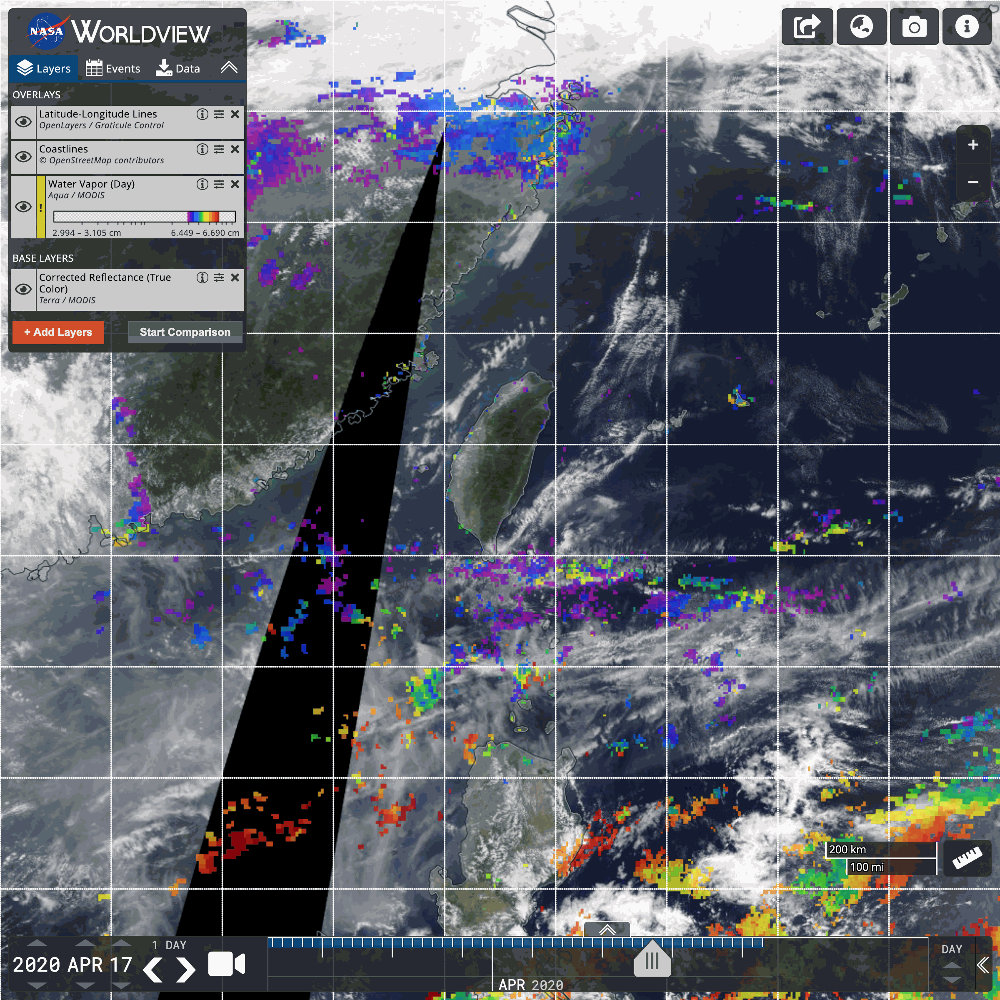

In [11]:
from IPython.display import Image,display
with open('./image_com.gif','rb') as f:
    display(Image(data=f.read(), format='png', width=600, height=600))